In [57]:
%run basic_material
import numpy as np
from casadi_lossless_rk45 import Rocket
from attitude import Attitude
import time
import pylab as pl
from IPython import display
from scipy.integrate import solve_ivp
import time

from matplotlib import pyplot as plt, rc
from matplotlib.animation import FuncAnimation, PillowWriter, FFMpegWriter
rc('animation', html='jshtml')

from IPython.display import display

Running Python: 3.11.3


In [58]:
N = 50
N2 = 50
alpha = 0.00 #solve_ivp and casadi RK45 perform differently with nonlinearities, probably because of small N. Instead of using solveivp, should implement RK45 propagation from sratch and evaluate at N points
m0 = 100
x00 = [50,120,0,0,m0]
x0 = x00
states = np.array([x0])
rocket = Rocket(N,alpha)
Tx, Ty = [0,3]
Txarr, Tyarr, sigmaarr, Tf, x, y, vx, vy, m = rocket.input(x0,[Tx,Ty])
theta_ref = np.arctan2(Txarr,Tyarr)
omega_ref = np.diff(theta_ref)/(Tf/N)
t_eval = np.linspace(0,Tf,N)

for i in range(N):
    Tx = Txarr[i]
    Ty = Tyarr[i]
    def ode(t,state):
        x,y,dx,dy,m = state
        ddx = Tx*m0/m
        ddy = Ty*m0/m - 9.81
        dm = -alpha*np.sqrt(Tx**2+Ty**2)/m0
        return [dx,dy,ddx,ddy,dm]

    sol = solve_ivp(ode,[0,Tf/N],x0,method='RK45')
    x0 = sol.y[:,-1]
    print(x0)
    states = np.vstack((states,x0))

[ 50.0000  119.9007 -0.0000 -1.1632  100.0000]
[ 49.9562  119.5596 -0.5124 -2.8300  100.0000]
[ 49.8251  118.9368 -1.0230 -4.4624  100.0000]
[ 49.6071  118.0383 -1.5292 -6.0583  100.0000]
[ 49.3033  116.8705 -2.0279 -7.6160  100.0000]
[ 48.9153  115.4399 -2.5157 -9.1345  100.0000]
[ 48.4452  113.7534 -2.9889 -10.6133  100.0000]
[ 47.8958  111.8176 -3.4438 -12.0531  100.0000]
[ 47.2706  109.6391 -3.8770 -13.4550  100.0000]
[ 46.5734  107.2242 -4.2857 -14.8215  100.0000]
[ 45.8088  104.5786 -4.6674 -16.1552  100.0000]
[ 44.9814  101.7078 -5.0206 -17.4596  100.0000]
[ 44.0962  98.6164 -5.3445 -18.7380  100.0000]
[ 43.1582  95.3085 -5.6388 -19.9942  100.0000]
[ 42.1724  91.7877 -5.9041 -21.2313  100.0000]
[ 41.1436  88.0569 -6.1413 -22.4527  100.0000]
[ 40.0767  84.1186 -6.3515 -23.6609  100.0000]
[ 38.9760  79.9749 -6.5363 -24.8585  100.0000]
[ 37.8459  75.6273 -6.6972 -26.0473  100.0000]
[ 36.6756  71.1288 -7.0050 -26.6261  100.0000]
[ 35.4289  66.6507 -7.5935 -25.8083  100.0000]
[ 34.08

Plots for casadi values

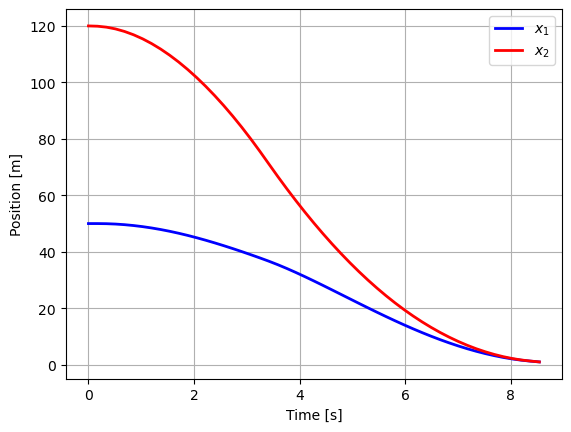

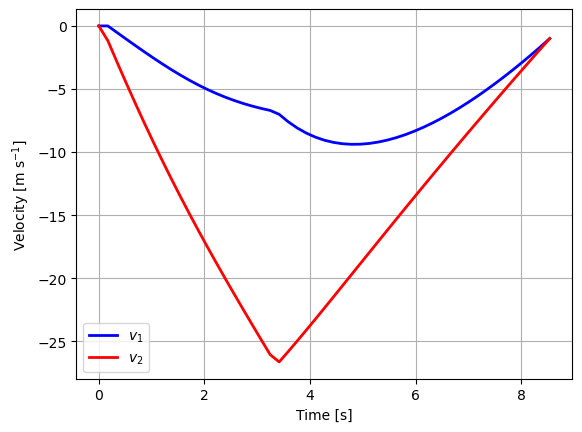

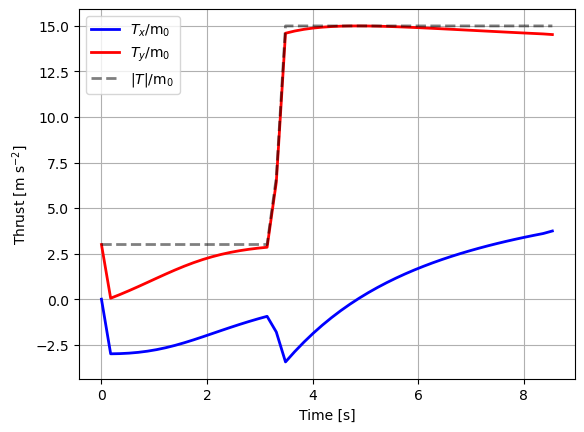

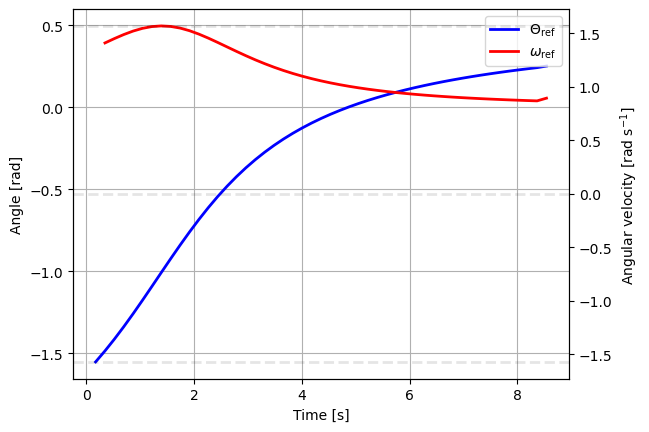

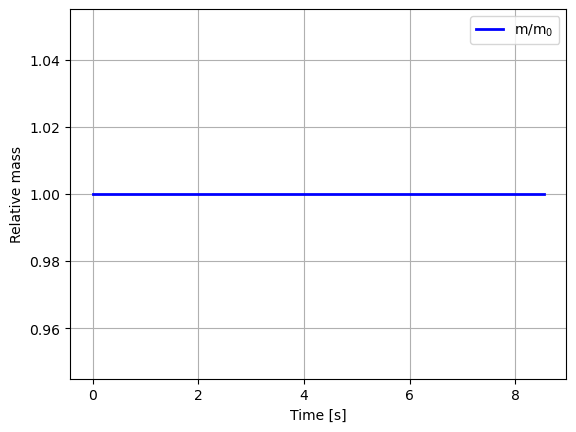

In [59]:
t_plot = np.linspace(0,Tf,N+1)
plt.plot(t_plot,x,color='b')
plt.plot(t_plot,y,color='r')
#plt.plot(t_plot,x,color='b',linestyle='--')
#plt.plot(t_plot,y,color='r',linestyle='--')
plt.xlabel('Time [s]')
plt.ylabel('Position [m]')
#plt.legend(['$x_1$','$x_2$', '$x_1^*$','$x_2^*$'])
plt.legend(['$x_1$','$x_2$'])

plt.figure()
plt.plot(t_plot,vx,color='b')
plt.plot(t_plot,vy,color='r')

plt.xlabel('Time [s]')
plt.ylabel('Velocity [m $\mathrm{s}^{-1}$]')
plt.legend(['$v_1$','$v_2$'])

plt.figure()
plt.plot(t_eval,Txarr,color='b')
plt.plot(t_eval,Tyarr,color='r')
plt.plot(t_eval,np.sqrt(Txarr**2 + Tyarr**2),color='black',linestyle='--',alpha=0.5)
plt.xlabel('Time [s]')
plt.ylabel('Thrust [m $\mathrm{s}^{-2}$]')
plt.legend(['$T_x/\mathrm{m}_0$','$T_y/\mathrm{m}_0$','$|T|/\mathrm{m}_0$'])

plt.figure()
plt.plot(t_eval[1:],theta_ref[1:],color='blue')
plt.plot(t_eval[2:],omega_ref[1:],color='red')

plt.xlabel('Time [s]')
plt.ylabel('Angle [rad]')
plt.legend(['$\Theta_{\mathrm{ref}}$', '$\omega_{\mathrm{ref}}$'])
#label on y axis of both sides
plt.twinx()
plt.grid()
plt.ylabel('Angular velocity [rad $\mathrm{s}^{-1}$] ')

#line at np pi
plt.axhline(y=np.pi/2,color='black',linestyle='--',alpha=0.1)
plt.axhline(y=-np.pi/2,color='black',linestyle='--',alpha=0.1)
plt.axhline(y=0,color='black',linestyle='--',alpha=0.1)

plt.figure()
plt.plot(t_eval,m/m0,color='b')
plt.xlabel('Time [s]')
plt.ylabel('Relative mass')
plt.legend(['$\mathrm{m}/\mathrm{m}_0$'])


Plots for scipy values

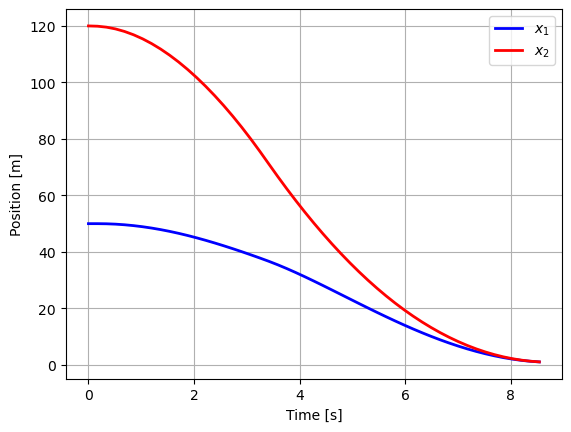

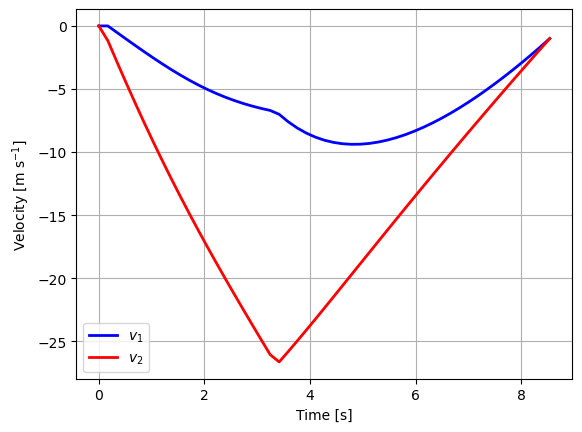

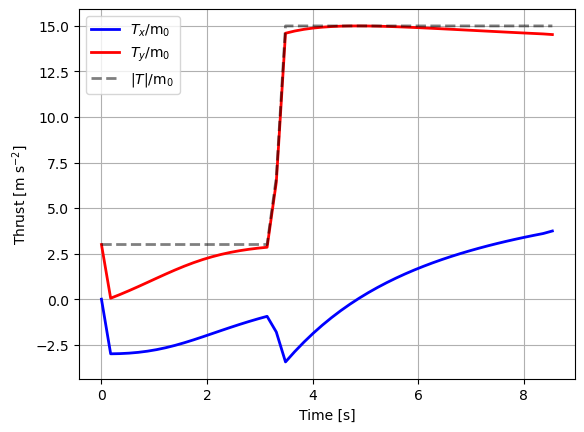

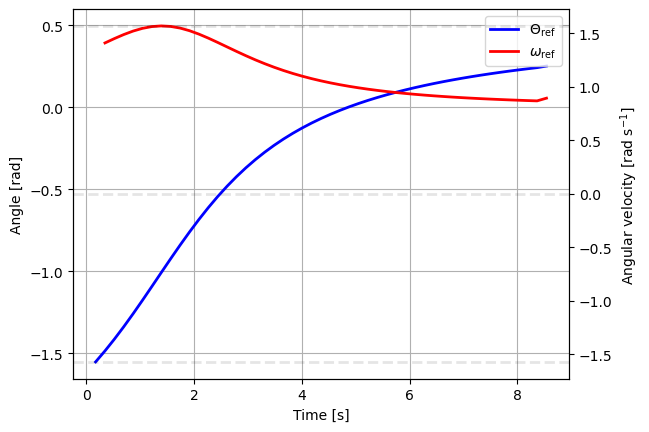

In [60]:
t_plot = np.linspace(0,Tf,N+1)
plt.plot(t_plot,states[:,0],color='b')
plt.plot(t_plot,states[:,1],color='r')
#plt.plot(t_plot,x,color='b',linestyle='--')
#plt.plot(t_plot,y,color='r',linestyle='--')
plt.xlabel('Time [s]')
plt.ylabel('Position [m]')
#plt.legend(['$x_1$','$x_2$', '$x_1^*$','$x_2^*$'])
plt.legend(['$x_1$','$x_2$'])

plt.figure()
plt.plot(t_plot,states[:,2],color='b')
plt.plot(t_plot,states[:,3],color='r')

plt.xlabel('Time [s]')
plt.ylabel('Velocity [m $\mathrm{s}^{-1}$]')
plt.legend(['$v_1$','$v_2$'])

plt.figure()
plt.plot(t_eval,Txarr,color='b')
plt.plot(t_eval,Tyarr,color='r')
plt.plot(t_eval,np.sqrt(Txarr**2 + Tyarr**2),color='black',linestyle='--',alpha=0.5)
plt.xlabel('Time [s]')
plt.ylabel('Thrust [m $\mathrm{s}^{-2}$]')
plt.legend(['$T_x/\mathrm{m}_0$','$T_y/\mathrm{m}_0$','$|T|/\mathrm{m}_0$'])

plt.figure()
plt.plot(t_eval[1:],theta_ref[1:],color='blue')
plt.plot(t_eval[2:],omega_ref[1:],color='red')

plt.xlabel('Time [s]')
plt.ylabel('Angle [rad]')
plt.legend(['$\Theta_{\mathrm{ref}}$', '$\omega_{\mathrm{ref}}$'])
#label on y axis of both sides
plt.twinx()
plt.grid()
plt.ylabel('Angular velocity [rad $\mathrm{s}^{-1}$] ')

#line at np pi
plt.axhline(y=np.pi/2,color='black',linestyle='--',alpha=0.1)
plt.axhline(y=-np.pi/2,color='black',linestyle='--',alpha=0.1)
plt.axhline(y=0,color='black',linestyle='--',alpha=0.1)


In [61]:
attitude = Attitude(Tf/N,N2)
t_eval = np.linspace(0,Tf,N)

In [62]:
x1 = np.append(x00,[theta_ref[1],omega_ref[2]])
states1 = np.append(x1,[0,0]) #record thrust too

# translational dynamics
for i in range(N-3):
    x,y,dx,dy,m,theta,omega = x1
    while True:
        try:
            print([theta,omega],[theta_ref[i+1],omega_ref[i+2]])
            tau,tf = attitude.input([theta,omega],[theta_ref[i+1],omega_ref[i+2]])
            print("tf",tf)
            print("tau",tau)
        except ValueError:
            print("ValueError")
            time.sleep(2)
            continue
        break
    
    Tx = Txarr[i]
    Ty = Tyarr[i]
    Tabs = np.sqrt(Tx**2 + Ty**2)
    ## attitude dynamics
    for j in range(N2):
        def ode(t,state):
            x,y,dx,dy,m,theta,omega = state
            ddx = Tabs*np.sin(theta)*m0/m
            ddy = Tabs*np.cos(theta)*m0/m - 9.81
            domega = tau[j]
            dm = -alpha*np.sqrt(Tx**2+Ty**2)/m0
            return [dx,dy,ddx,ddy,dm,omega,domega]
        
        sol = solve_ivp(ode,[0,Tf/N/N2],x1)
        x1 = sol.y[:,-1]
        states1 = np.vstack((states1,np.append(x1,[Tx,Ty])))

[-1.5535044343314908, 0.4198962934788259] [-1.5535044343314908, 0.4198962934788259]
tf 0.33637097172640934
tau [-4.9965 -4.9964 -4.9962 -4.9961 -4.9959 -4.9957 -4.9954 -4.9952 -4.9949
 -4.9945 -4.9942 -4.9937 -4.9932 -4.9926 -4.9919 -4.9911 -4.9900 -4.9887
 -4.9870 -4.9846 -4.9812 -4.9758 -4.9661 -4.9435 -4.8418  4.8418  4.9435
  4.9661  4.9758  4.9812  4.9846  4.9870  4.9887  4.9900  4.9911  4.9919
  4.9926  4.9932  4.9937  4.9942  4.9945  4.9949  4.9952  4.9954  4.9957
  4.9959  4.9961  4.9962  4.9964  4.9965]
[-1.518202753363086, 0.41989629347882584] [-1.4863266246358524, 0.44454914943303947]
tf 0.23958868991791674
tau [-4.9973 -4.9971 -4.9970 -4.9969 -4.9967 -4.9965 -4.9963 -4.9961 -4.9959
 -4.9956 -4.9953 -4.9949 -4.9945 -4.9940 -4.9934 -4.9927 -4.9918 -4.9906
 -4.9891 -4.9869 -4.9836 -4.9782 -4.9674 -4.9363  0.1494  4.9347  4.9672
  4.9781  4.9836  4.9869  4.9890  4.9906  4.9918  4.9927  4.9934  4.9940
  4.9945  4.9949  4.9953  4.9956  4.9959  4.9961  4.9963  4.9965  4.9967
  4.9

Text(0, 0.5, 'Angular velocity [rad $\\mathrm{s}^{-1}$] ')

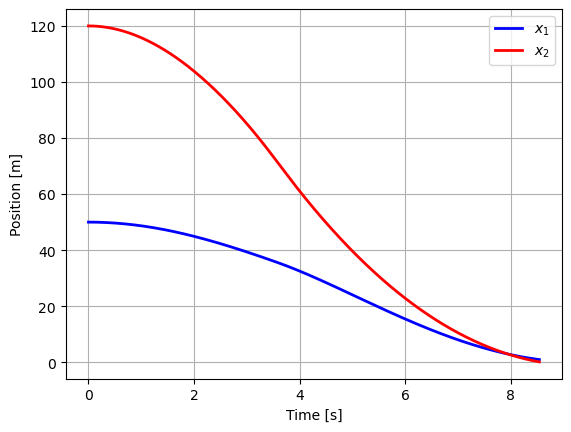

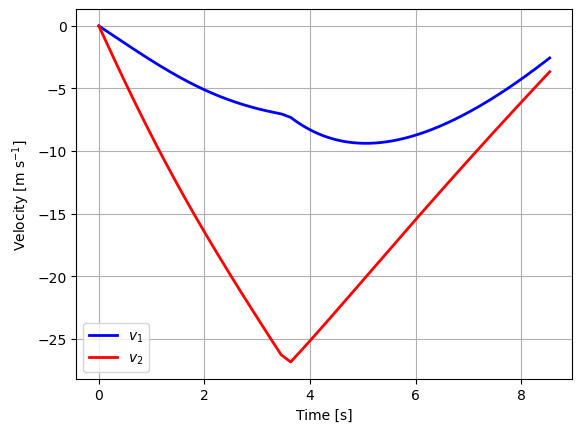

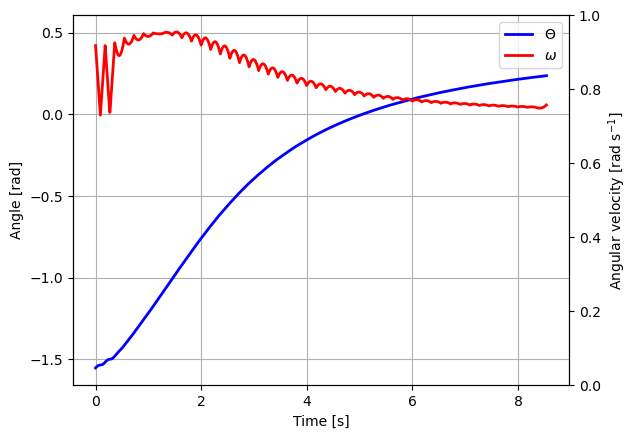

In [63]:
t_plot = np.linspace(0,Tf,states1.shape[0])
plt.plot(t_plot,states1[:,0],color='b')
plt.plot(t_plot,states1[:,1],color='r')
plt.xlabel('Time [s]')
plt.ylabel('Position [m]')
plt.legend(['$x_1$','$x_2$'])

plt.figure()
plt.plot(t_plot,states1[:,2],color='b')
plt.plot(t_plot,states1[:,3],color='r')

plt.xlabel('Time [s]')
plt.ylabel('Velocity [m $\mathrm{s}^{-1}$]')
plt.legend(['$v_1$','$v_2$'])


plt.figure()
plt.plot(t_plot,states1[:,5],color='blue')
plt.plot(t_plot,states1[:,6],color='red')
""" plt.plot(theta_ref[:-2],color='blue',linestyle='--',alpha=0.5)
plt.plot(omega_ref[1:],color='red',linestyle='--',alpha=0.5) """

plt.xlabel('Time [s]')
plt.ylabel('Angle [rad]')
plt.legend(['$\Theta$', '$\omega$','$\Theta_{\mathrm{ref}}$', '$\omega_{\mathrm{ref}}$'])
#label on y axis of both sides
plt.twinx()
plt.grid()
plt.ylabel('Angular velocity [rad $\mathrm{s}^{-1}$] ')


Generating Animation
0
0.0 %
0
0.0 %
1
0.425531914893617 %
2
0.851063829787234 %
3
1.276595744680851 %
4
1.702127659574468 %
5
2.127659574468085 %
6
2.553191489361702 %
7
2.9787234042553195 %
8
3.404255319148936 %
9
3.829787234042553 %
10
4.25531914893617 %
11
4.680851063829787 %
12
5.106382978723404 %
13
5.531914893617021 %
14
5.957446808510639 %
15
6.382978723404255 %
16
6.808510638297872 %
17
7.234042553191489 %
18
7.659574468085106 %
19
8.085106382978724 %
20
8.51063829787234 %
21
8.936170212765958 %
22
9.361702127659575 %
23
9.787234042553191 %
24
10.212765957446807 %
25
10.638297872340425 %
26
11.063829787234042 %
27
11.48936170212766 %
28
11.914893617021278 %
29
12.340425531914894 %
30
12.76595744680851 %
31
13.191489361702127 %
32
13.617021276595745 %
33
14.042553191489363 %
34
14.468085106382977 %
35
14.893617021276595 %
36
15.319148936170212 %
37
15.74468085106383 %
38
16.170212765957448 %
39
16.595744680851062 %
40
17.02127659574468 %
41
17.4468085106383 %
42
17.872340425531

0
0.0 %


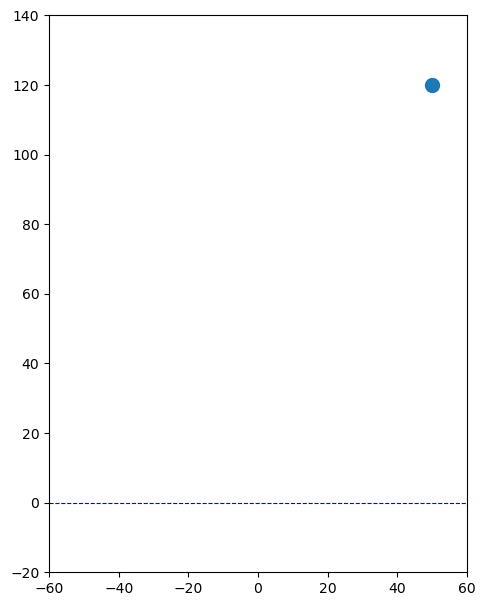

In [66]:
print("Generating Animation")
div = 10
steps = int(states1.shape[0]/div)
final_time_step = round(1/steps,2)

xsim = states1[:-2,0].reshape(-1,1)
vxsim = states1[:-2,2].reshape(-1,1)
ysim = states1[:-2,1].reshape(-1,1)
vysim = states1[:-2,3].reshape(-1,1)
txsim = states1[:-2,7].reshape(-1,1)
tysim = states1[:-2,8].reshape(-1,1)

anglesim = states1[:-2,5].reshape(-1,1)
thrustsim = np.sqrt(txsim**2 + tysim**2)
x_t = np.hstack([xsim,vxsim,ysim,vysim,anglesim,txsim,tysim])[::div,:]
u_t = np.hstack([thrustsim,anglesim])[::div,:]

fig = plt.figure(figsize = (5,8), constrained_layout=False)
ax1 = fig.add_subplot(111)
plt.axhline(y=0., color='b', linestyle='--', lw=0.8)

ln6, = ax1.plot([], [], '--', linewidth = 2, color = 'orange') # trajectory line
ln2, = ax1.plot([], [], linewidth = 2, color = 'tomato') # thrust line
ln1, = ax1.plot([], [], marker = 'o', markersize = 10)

plt.tight_layout()

ax1.set_xlim(-60, 60)
ax1.set_ylim(-20, 140)
ax1.set_aspect(1)
ax1.grid(False)
length = 10
def update(i):
    print(i)
    print(i/x_t.shape[0]*100,"%")
    j = i
    rocket_x = x_t[j,0]
    # length/1 is just to make rocket bigger in animation
    rocket_x_points = [rocket_x, rocket_x]

    rocket_y = x_t[j, 2]
    rocket_y_points = [rocket_y, rocket_y]

    ln1.set_data([rocket_x], [rocket_y])

    thrust_mag = u_t[j, 0]
    thrust_angle = u_t[j, 1]

    flame_length = (thrust_mag) * (0.4)*5
    flame_x_points = [rocket_x_points[1], rocket_x_points[1] - flame_length * np.sin(thrust_angle)]
    flame_y_points = [rocket_y_points[1], rocket_y_points[1] - flame_length * np.cos(thrust_angle)]

    ln2.set_data(flame_x_points, flame_y_points)
    ln6.set_data(x_t[:j, 0], x_t[:j, 2])


playback_speed = 6500 # the higher the slower 
anim = FuncAnimation(fig, update, np.arange(0, steps, 1))

anim

In [65]:
""" anim.save('rocket_landing.gif') """

" anim.save('rocket_landing.gif') "